In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/home-credit-default-risk/sample_submission.csv
/kaggle/input/home-credit-default-risk/bureau_balance.csv
/kaggle/input/home-credit-default-risk/POS_CASH_balance.csv
/kaggle/input/home-credit-default-risk/application_train.csv
/kaggle/input/home-credit-default-risk/HomeCredit_columns_description.csv
/kaggle/input/home-credit-default-risk/application_test.csv
/kaggle/input/home-credit-default-risk/previous_application.csv
/kaggle/input/home-credit-default-risk/credit_card_balance.csv
/kaggle/input/home-credit-default-risk/installments_payments.csv
/kaggle/input/home-credit-default-risk/bureau.csv


In [2]:
from sklearn.preprocessing import LabelEncoder
import os
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
from scipy.stats import pearsonr
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer

In [3]:
trainData = pd.read_csv('/kaggle/input/home-credit-default-risk/application_train.csv')
print('Shape:',trainData.shape)
trainData.head()

Shape: (307511, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
testData= pd.read_csv('/kaggle/input/home-credit-default-risk/application_test.csv')
print('Shape:',testData.shape)
testData.head()

Shape: (48744, 121)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
# Data type summary of columns
print(trainData.dtypes.value_counts())

float64    65
int64      41
object     16
Name: count, dtype: int64


In [6]:
missing_values = (trainData.isnull().sum() / len(trainData)) * 100
print(pd.DataFrame({"Column Names": missing_values.index, "Percentage": missing_values.values}).sort_values(by="Percentage", ascending=False).head(20))

                Column Names  Percentage
76           COMMONAREA_MEDI   69.872297
48            COMMONAREA_AVG   69.872297
62           COMMONAREA_MODE   69.872297
70  NONLIVINGAPARTMENTS_MODE   69.432963
56   NONLIVINGAPARTMENTS_AVG   69.432963
84  NONLIVINGAPARTMENTS_MEDI   69.432963
86        FONDKAPREMONT_MODE   68.386172
68     LIVINGAPARTMENTS_MODE   68.354953
54      LIVINGAPARTMENTS_AVG   68.354953
82     LIVINGAPARTMENTS_MEDI   68.354953
52             FLOORSMIN_AVG   67.848630
66            FLOORSMIN_MODE   67.848630
80            FLOORSMIN_MEDI   67.848630
75          YEARS_BUILD_MEDI   66.497784
61          YEARS_BUILD_MODE   66.497784
47           YEARS_BUILD_AVG   66.497784
21               OWN_CAR_AGE   65.990810
81             LANDAREA_MEDI   59.376738
67             LANDAREA_MODE   59.376738
53              LANDAREA_AVG   59.376738


In [7]:
trainData['TARGET'].value_counts()

TARGET
0    282686
1     24825
Name: count, dtype: int64

**Visualization**

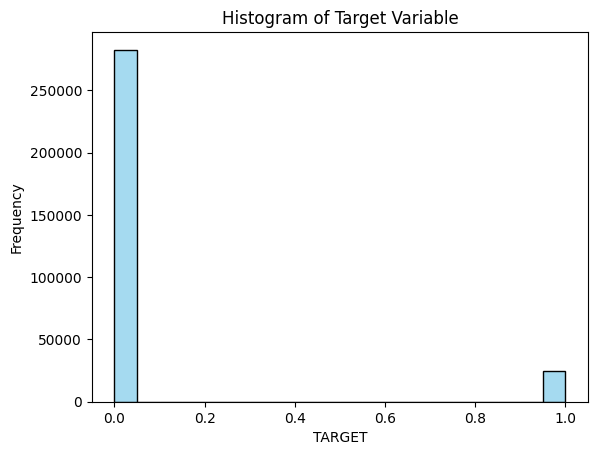

In [8]:
# Frequency of each Target type- Default and Non-Default
sns.histplot(trainData['TARGET'], color='skyblue')
plt.xlabel('TARGET')
plt.ylabel('Frequency')
plt.title('Histogram of Target Variable')

plt.show()

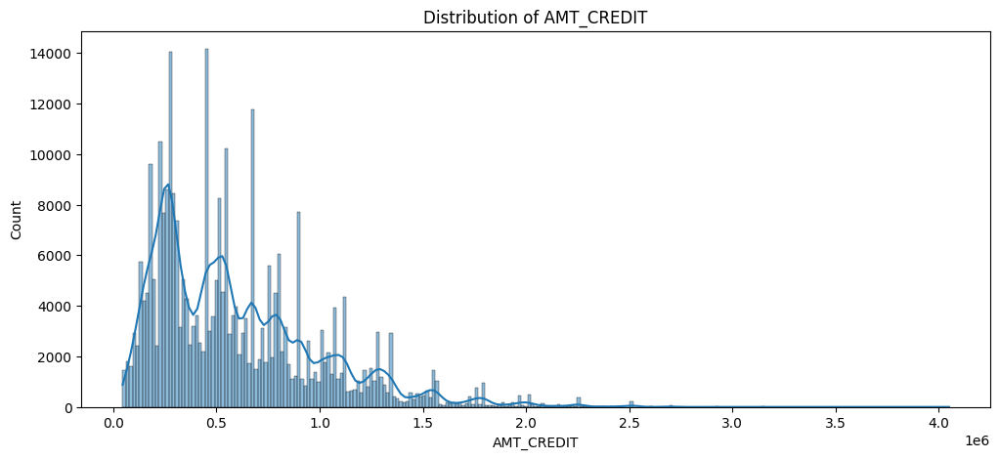

In [9]:
# Disribution of AMT_CREDIT
plt.figure(figsize=(12, 5))
ax = sns.histplot(trainData["AMT_CREDIT"], kde=True)
ax.set_title("Distribution of AMT_CREDIT")
ax.set_xlabel("AMT_CREDIT")
ax.set_ylabel("Count")
plt.show()

In [10]:
# Function to visualize and compare the distribution of a categorical feature
def plot_categorical(data, col, size=(12, 6), xlabel_angle=0, title=''):
    label1 = data.loc[data.TARGET == 1, col].value_counts()
    label0 = data.loc[data.TARGET == 0, col].value_counts()

    fig, axes = plt.subplots(1, 2, figsize=size)

    sns.barplot(x=label1.index, y=label1.values, ax=axes[0])
    axes[0].set_title('Default: ' + title)
    axes[0].tick_params(axis='x', rotation=xlabel_angle)

    sns.barplot(x=label0.index, y=label0.values, ax=axes[1])
    axes[1].set_title('Non-default: ' + title)
    axes[1].tick_params(axis='x', rotation=xlabel_angle)

    plt.show()

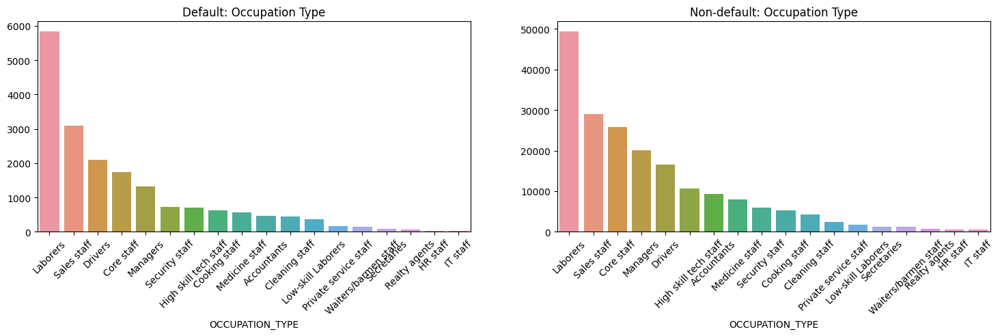

In [11]:
# Occupation type
plot_categorical(data=trainData, col='OCCUPATION_TYPE', size=(18, 4), xlabel_angle=45, title='Occupation Type')

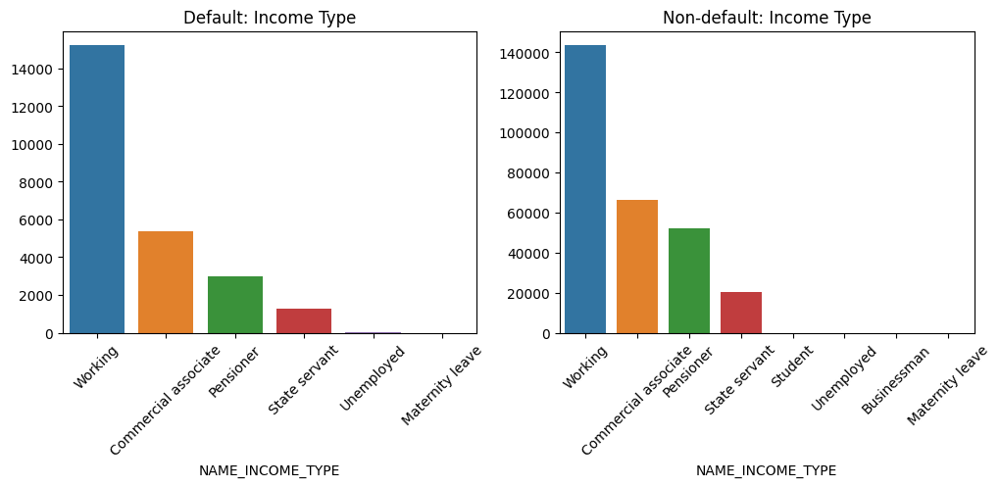

In [12]:
# Income Type
plot_categorical(data=trainData, col='NAME_INCOME_TYPE', size=(12, 4), xlabel_angle=45, title='Income Type')

In [13]:
# Income type
fig = px.pie(trainData, width=800, height=600, names=trainData['NAME_INCOME_TYPE'].value_counts().index,
             values=trainData['NAME_INCOME_TYPE'].value_counts().values,
             title='Income Type')
fig.show()

In [14]:
# Number of clients occupation type
fig = px.histogram(trainData, x="OCCUPATION_TYPE",
                  barmode='group', text_auto='.2s').update_xaxes(categoryorder = "total descending")
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_layout(title="Number of Clients by Occupation Type")
fig.show()

In [15]:
# Number of clients in each target class by occupation type
fig = px.histogram(trainData, x="OCCUPATION_TYPE",
                   color="TARGET", barmode='group').update_xaxes(categoryorder = "total descending")
fig.update_layout(title="Number of clients in each target class by occupation type")
fig.show()

In [16]:
# Number of clients in each target class by organization type
fig = px.histogram(trainData, x="ORGANIZATION_TYPE",
                   color="TARGET", barmode='group').update_xaxes(categoryorder = "total descending")
fig.update_layout(title="Number of clients in each target class by organization type")
fig.show()

In [17]:
# Distribution of age of clients
fig = px.histogram(x= np.abs(trainData['DAYS_BIRTH'])/365,
                  barmode='group', nbins=15,  title="Distribution of Age of Clients").update_xaxes(categoryorder = "total descending")
fig.update_layout(bargap=0.05,
                  xaxis = dict(title='Age (years)'))
fig.show()

In [18]:
# Distribution of age of clients by target
fig = ff.create_distplot([np.abs(trainData.loc[trainData['TARGET'] == 0, 'DAYS_BIRTH']) / 365,
                         np.abs(trainData.loc[trainData['TARGET'] == 1, 'DAYS_BIRTH']) / 365],
                         ['target = 0', 'target = 1'],
                         bin_size = [2, 2],
                         show_rug=False,
                         show_hist=False,
                         show_curve=True)

fig.update_layout(title="Distribution of Age of Clients by Target",
                  xaxis=dict(title='Age (years)'),
                  yaxis=dict(title='Density'),
                  barmode='overlay')

fig.show()

In [19]:
# Loan Types
temp = trainData["NAME_CONTRACT_TYPE"].value_counts()

fig = px.pie(temp, labels=temp.index, values=temp.values, hole=0.7,
             title="Types of Loan",
             template="plotly",
             names=temp.index)

fig.update_traces(textinfo="percent+label")

fig.show()

In [20]:
# Checking if Data is balanced or imbalanced
# Calculate value counts for the 'TARGET' variable
temp = trainData["TARGET"].value_counts()

fig = px.pie(values=temp.values, names=temp.index, title='Loan Repaid or Not')
fig.show()

In [21]:
import plotly.express as px

# Grouping by assets and target
temp1 = trainData.groupby(['TARGET', 'FLAG_OWN_CAR']).size().reset_index(name='count')
temp2 = trainData.groupby(['TARGET', 'FLAG_OWN_REALTY']).size().reset_index(name='count')

# Plot for Own Car
fig1 = px.pie(
    temp1,
    values='count',
    names='FLAG_OWN_CAR',
    color='FLAG_OWN_CAR',
    hole=0.6,
    title='Loan Default by Car Ownership'
)

# Plot for Own Realty
fig2 = px.pie(
    temp2,
    values='count',
    names='FLAG_OWN_REALTY',
    color='FLAG_OWN_REALTY',
    hole=0.6,
    title='Loan Default by Realty Ownership'
)

fig1.update_traces(textinfo='percent+label', textposition='inside')
fig2.update_traces(textinfo='percent+label', textposition='inside')

fig1.show()
fig2.show()


In [22]:
# Function to plot numerical data
def plot_numerical(data, col, size=[8, 4], bins=50):
    plt.figure(figsize=size)
    plt.title("Distribution of %s" % col)
    ax = sns.histplot(data[col], kde=True)
    plt.show()

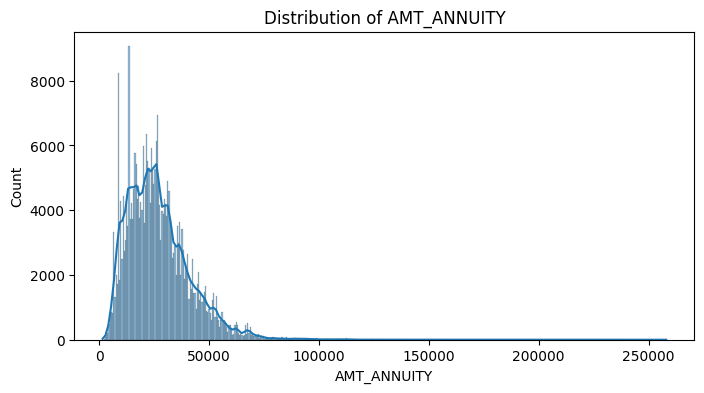

In [23]:
# Annuity Amount
plot_numerical(trainData, 'AMT_ANNUITY')

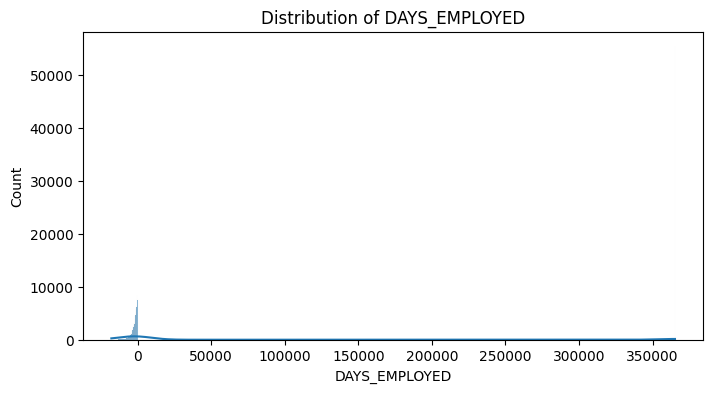

In [24]:
# Total number of days employed plot
plot_numerical(trainData, 'DAYS_EMPLOYED')

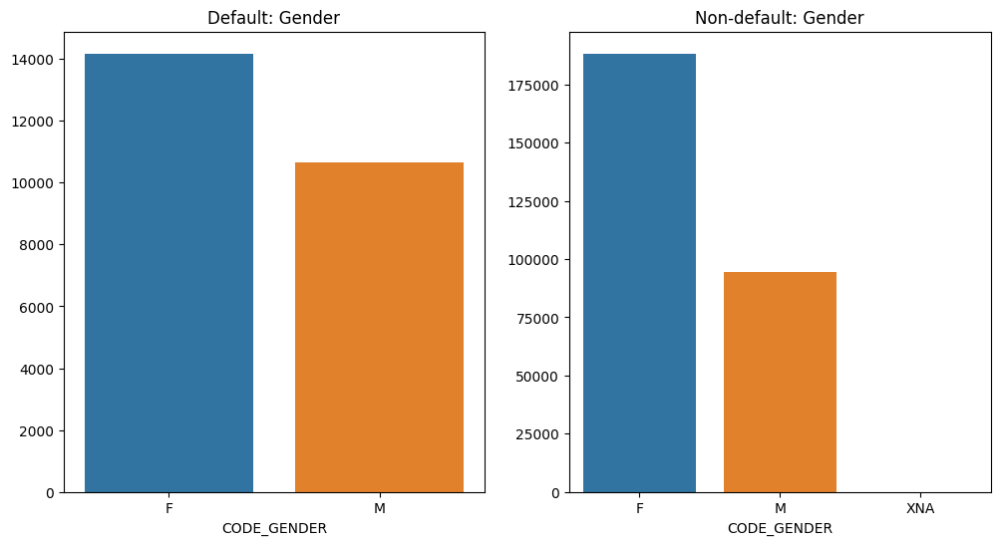

In [25]:
# Gender count plot
plot_categorical(trainData, 'CODE_GENDER', title='Gender')

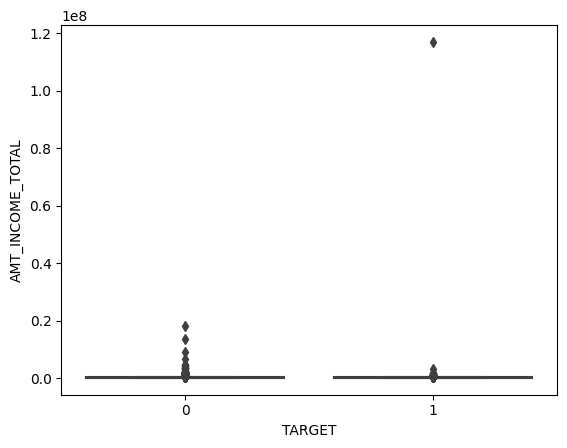

In [26]:
#Box plot for amt_credit_total
fig = sns.boxplot(data=trainData, y = trainData['AMT_INCOME_TOTAL'], x=trainData['TARGET'])
fig.get_figure();

In [27]:
#  Function to split the data based on type
def feature_type_split(data, special_list=[]):
    categoricalList = []
    discreteNumList = []
    numList = []

    for i in data.columns:
        if data[i].dtype == 'object':
            categoricalList.append(i)
        elif data[i].nunique() < 25 or i in special_list:
            discreteNumList.append(i)
        else:
            numList.append(i)

    return categoricalList, discreteNumList, numList

categoricalList, discreteNumList, numList = feature_type_split(trainData, special_list=['AMT_REQ_CREDIT_BUREAU_YEAR'])

In [28]:
#calculating the outliers using 1.5 IQR
def findOutliers(data, feature, df):
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    outlierCount = 0
    for i in range(len(data)):
        if data[i] > Q3 + 1.5 * (IQR) or data[i] < Q1 - 1.5 * (IQR):
            outlierCount += 1
    percent = outlierCount / len(data) * 100
    newrow = pd.DataFrame({
        "Feature": [feature],
        "Percentage": [round(percent, 1)]
    })
    df = pd.concat([df, newrow], ignore_index=True)
    return df

In [29]:
df = pd.DataFrame()
columns = discreteNumList + numList
for column_name in columns:
  df = findOutliers(trainData[column_name].tolist(),column_name,df)

In [30]:
print(df)

                      Feature  Percentage
0                      TARGET         8.1
1                CNT_CHILDREN         1.4
2                  FLAG_MOBIL         0.0
3              FLAG_EMP_PHONE        18.0
4             FLAG_WORK_PHONE        19.9
..                        ...         ...
101        NONLIVINGAREA_MEDI         0.0
102            TOTALAREA_MODE         0.0
103  OBS_30_CNT_SOCIAL_CIRCLE         0.0
104  OBS_60_CNT_SOCIAL_CIRCLE         0.0
105    DAYS_LAST_PHONE_CHANGE         0.0

[106 rows x 2 columns]


In [31]:
sorted_df = df.sort_values(by='Percentage', ascending=False)
sorted_df.head(20)

,Feature,Percentage
9,REGION_RATING_CLIENT,26.2
10,REGION_RATING_CLIENT_W_CITY,25.4
53,DAYS_EMPLOYED,23.5
16,REG_CITY_NOT_WORK_CITY,23.0
4,FLAG_WORK_PHONE,19.9
3,FLAG_EMP_PHONE,18.0
17,LIVE_CITY_NOT_WORK_CITY,18.0
24,FLAG_DOCUMENT_6,8.8
26,FLAG_DOCUMENT_8,8.1
0,TARGET,8.1


**Missing value summary**

In [32]:
#inspecting how many unique values each categorical variable have
categoricalVar = trainData.select_dtypes('object')
categoricalVar.apply(pd.Series.nunique, axis = 0)

NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

In [33]:
#one hot encoding
train_encoded = pd.get_dummies(trainData)
test_encoded = pd.get_dummies(testData)

In [34]:
print(train_encoded.shape)
print(test_encoded.shape)

(307511, 246)
(48744, 242)


In [35]:
train_encoded.columns

Index(['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       ...
       'HOUSETYPE_MODE_terraced house', 'WALLSMATERIAL_MODE_Block',
       'WALLSMATERIAL_MODE_Mixed', 'WALLSMATERIAL_MODE_Monolithic',
       'WALLSMATERIAL_MODE_Others', 'WALLSMATERIAL_MODE_Panel',
       'WALLSMATERIAL_MODE_Stone, brick', 'WALLSMATERIAL_MODE_Wooden',
       'EMERGENCYSTATE_MODE_No', 'EMERGENCYSTATE_MODE_Yes'],
      dtype='object', length=246)

In [36]:
#aligning the training and testing data since the number of columns doesn't match after encoding
train_encoded_target = train_encoded['TARGET']
train_encoded, test_encoded = train_encoded.align(test_encoded, join = 'inner', axis = 1)


In [37]:
print(train_encoded.columns)

Index(['SK_ID_CURR', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT',
       'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE',
       'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION',
       ...
       'HOUSETYPE_MODE_terraced house', 'WALLSMATERIAL_MODE_Block',
       'WALLSMATERIAL_MODE_Mixed', 'WALLSMATERIAL_MODE_Monolithic',
       'WALLSMATERIAL_MODE_Others', 'WALLSMATERIAL_MODE_Panel',
       'WALLSMATERIAL_MODE_Stone, brick', 'WALLSMATERIAL_MODE_Wooden',
       'EMERGENCYSTATE_MODE_No', 'EMERGENCYSTATE_MODE_Yes'],
      dtype='object', length=242)


In [38]:
train_encoded['TARGET'] = train_encoded_target

In [39]:
# Create an instance of SimpleImputer
imputer = SimpleImputer(strategy='median')

# Transform both training and testing data
train_encoded = pd.DataFrame(imputer.fit_transform(train_encoded),columns=train_encoded.columns)
test_encoded = pd.DataFrame(imputer.fit_transform(test_encoded),columns=test_encoded.columns)

In [40]:
print(test_encoded.isna().sum().sum())

0


In [41]:
corr = train_encoded.corr()['TARGET']
corr = corr.sort_values()

In [42]:
print(corr.head(20))

EXT_SOURCE_2                           -0.160295
EXT_SOURCE_3                           -0.155892
EXT_SOURCE_1                           -0.098887
NAME_EDUCATION_TYPE_Higher education   -0.056593
CODE_GENDER_F                          -0.054704
NAME_INCOME_TYPE_Pensioner             -0.046209
ORGANIZATION_TYPE_XNA                  -0.045987
DAYS_EMPLOYED                          -0.044932
EMERGENCYSTATE_MODE_No                 -0.042201
HOUSETYPE_MODE_block of flats          -0.040594
AMT_GOODS_PRICE                        -0.039623
FLOORSMAX_AVG                          -0.039385
FLOORSMAX_MEDI                         -0.039157
FLOORSMAX_MODE                         -0.038377
REGION_POPULATION_RELATIVE             -0.037227
ELEVATORS_AVG                          -0.035853
ELEVATORS_MEDI                         -0.035552
ELEVATORS_MODE                         -0.034220
WALLSMATERIAL_MODE_Panel               -0.033119
NAME_CONTRACT_TYPE_Revolving loans     -0.030896
Name: TARGET, dtype:

In [43]:
print(corr.tail(20))

OCCUPATION_TYPE_Drivers                              0.030303
NAME_CONTRACT_TYPE_Cash loans                        0.030896
DEF_60_CNT_SOCIAL_CIRCLE                             0.031401
DEF_30_CNT_SOCIAL_CIRCLE                             0.032394
LIVE_CITY_NOT_WORK_CITY                              0.032518
DAYS_REGISTRATION                                    0.041975
OCCUPATION_TYPE_Laborers                             0.043019
FLAG_DOCUMENT_3                                      0.044346
REG_CITY_NOT_LIVE_CITY                               0.044395
FLAG_EMP_PHONE                                       0.045982
NAME_EDUCATION_TYPE_Secondary / secondary special    0.049824
REG_CITY_NOT_WORK_CITY                               0.050994
DAYS_ID_PUBLISH                                      0.051457
CODE_GENDER_M                                        0.054713
DAYS_LAST_PHONE_CHANGE                               0.055218
NAME_INCOME_TYPE_Working                             0.057481
REGION_R

In [44]:
train_encoded['DAYS_BIRTH']

0         -9461.0
1        -16765.0
2        -19046.0
3        -19005.0
4        -19932.0
           ...   
307506    -9327.0
307507   -20775.0
307508   -14966.0
307509   -11961.0
307510   -16856.0
Name: DAYS_BIRTH, Length: 307511, dtype: float64

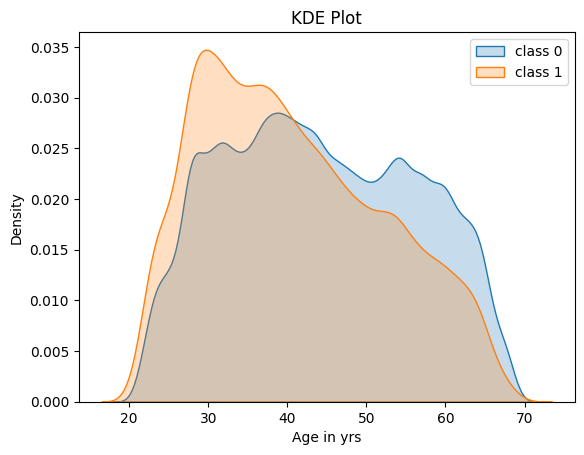

In [45]:
train_encoded['DAYS_BIRTH'] = abs(train_encoded['DAYS_BIRTH'])

#plotting a kde for days_birth
train_encoded0 = train_encoded[train_encoded['TARGET']==0]
train_encoded1 = train_encoded[train_encoded['TARGET']==1]
sns.kdeplot(train_encoded0['DAYS_BIRTH']/365,fill = True,label = 'class 0')
sns.kdeplot(train_encoded1['DAYS_BIRTH']/365,fill = True,label = 'class 1')
plt.xlabel("Age in yrs")
plt.ylabel("Density")
plt.title("KDE Plot")

# Display the plot
# plt.show()
plt.legend()


**Feature Engineering**


In [46]:
poly_train_features = train_encoded[['EXT_SOURCE_3','EXT_SOURCE_2','EXT_SOURCE_1','DAYS_BIRTH','REGION_RATING_CLIENT_W_CITY']]
poly_test_features = test_encoded[['EXT_SOURCE_3','EXT_SOURCE_2','EXT_SOURCE_1','DAYS_BIRTH','REGION_RATING_CLIENT_W_CITY']]
poly_target = train_encoded[['TARGET']]

In [47]:
polynomial_model = PolynomialFeatures(degree = 3)

In [48]:
polynomial_model.fit(poly_train_features)
polynomial_train_features = polynomial_model.transform(poly_train_features)
polynomial_test_features = polynomial_model.transform(poly_test_features)

In [49]:
polynomial_train_features = pd.DataFrame(polynomial_train_features, columns = polynomial_model.get_feature_names_out(['EXT_SOURCE_3','EXT_SOURCE_2','EXT_SOURCE_1','DAYS_BIRTH','REGION_RATING_CLIENT_W_CITY']))

In [50]:
polynomial_train_features['TARGET'] = poly_target

In [51]:
poly_corr = polynomial_train_features.corr()['TARGET'].sort_values()

In [52]:
print(poly_corr.head(10))
print(poly_corr.tail(5))

EXT_SOURCE_3 EXT_SOURCE_2                               -0.193939
EXT_SOURCE_3 EXT_SOURCE_2 EXT_SOURCE_1                  -0.189605
EXT_SOURCE_3 EXT_SOURCE_2 DAYS_BIRTH                    -0.181283
EXT_SOURCE_3 EXT_SOURCE_2^2                             -0.176428
EXT_SOURCE_3^2 EXT_SOURCE_2                             -0.172282
EXT_SOURCE_2 EXT_SOURCE_1                               -0.166625
EXT_SOURCE_3 EXT_SOURCE_2 REGION_RATING_CLIENT_W_CITY   -0.165126
EXT_SOURCE_3 EXT_SOURCE_1                               -0.164065
EXT_SOURCE_2                                            -0.160295
EXT_SOURCE_2 DAYS_BIRTH                                 -0.156873
Name: TARGET, dtype: float64
REGION_RATING_CLIENT_W_CITY^3    0.058058
REGION_RATING_CLIENT_W_CITY^2    0.060256
REGION_RATING_CLIENT_W_CITY      0.060893
TARGET                           1.000000
1                                     NaN
Name: TARGET, dtype: float64


In [53]:
polynomial_test_features = pd.DataFrame(polynomial_test_features, columns = polynomial_model.get_feature_names_out(['EXT_SOURCE_3','EXT_SOURCE_2','EXT_SOURCE_1','DAYS_BIRTH','REGION_RATING_CLIENT_W_CITY']))

In [54]:
print(polynomial_train_features.isna().sum().sum(),polynomial_test_features.isna().sum().sum())

0 0


In [55]:
polynomial_train_features['SK_ID_CURR'] = train_encoded['SK_ID_CURR']
poly_train_features_all = train_encoded.merge(polynomial_train_features, on = 'SK_ID_CURR', how = 'left')

In [56]:
polynomial_test_features['SK_ID_CURR'] = test_encoded['SK_ID_CURR']
poly_test_features_all = test_encoded.merge(polynomial_test_features, on = 'SK_ID_CURR', how = 'left')

In [57]:
poly_train_features_all, poly_test_features_all = poly_train_features_all.align(poly_test_features_all, join = 'inner', axis = 1)

In [58]:
print(poly_train_features_all.isna().sum().sum(),poly_test_features_all.isna().sum().sum())

0 0


In [59]:
print(poly_train_features_all.shape)
print( poly_test_features_all.shape)

(307511, 298)
(48744, 298)


In [60]:
poly_train_features_all['TARGET'] = poly_target

**Models**

In [61]:
application_train = poly_train_features_all
application_test = poly_test_features_all

In [62]:
application_train['TARGET']

0         1.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
307506    0.0
307507    0.0
307508    0.0
307509    1.0
307510    0.0
Name: TARGET, Length: 307511, dtype: float64

In [63]:
print(application_train.isna().sum().sum(),application_test.isna().sum().sum())

0 0


In [64]:
#  Correction of noise in Days Employed data
import plotly.express as px
import pandas as pd

fig = px.histogram(application_train, x='DAYS_EMPLOYED', nbins=30, title='Days Employment Histogram')

fig.update_xaxes(title_text='Days Employment')

# Show the plot
fig.show()

In [65]:
anomaly = application_train[application_train['DAYS_EMPLOYED'] == 365243]
print('The anomalies default on %0.2f%% of loans' % (100 * anomaly['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anomaly))

The anomalies default on 5.40% of loans
There are 55374 anomalous days of employment


In [66]:
# Replacing the anomalous values with nan
application_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

In [67]:
fig = px.histogram(application_train, x='DAYS_EMPLOYED', nbins=30, title='Days Employment Histogram')

fig.update_xaxes(title_text='Days Employment')

# Show the plot
anomaly = application_train[application_train['DAYS_EMPLOYED'] == 365243]
print('The anomalies default on %0.2f%% of loans' % (100 * anomaly['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anomaly))
fig.show()

The anomalies default on nan% of loans
There are 0 anomalous days of employment


In [68]:
anomaly = application_test[application_test['DAYS_EMPLOYED'] == 365243]
print('There are %d anomalous days of employment' % len(anomaly))

# Replace the anomalous values with nan
application_test['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

There are 9274 anomalous days of employment


**Classification Models**

In [69]:
application_train = pd.DataFrame(imputer.fit_transform(application_train),columns=application_train.columns)
application_test = pd.DataFrame(imputer.fit_transform(application_test),columns=application_test.columns)

In [70]:
print(application_train.isna().sum().sum(),application_test.isna().sum().sum())

0 0


In [71]:
df_train = application_train.drop('TARGET', axis=1)
target = application_train['TARGET']

In [72]:
from sklearn.model_selection import train_test_split

# Split the data into training and testing sets
X_train, X_validate, y_train, y_validate = train_test_split(df_train, target, test_size=0.2, random_state=42)

**Logisitic Regression**

In [73]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score, auc
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, precision_score, roc_curve

In [74]:
# Standardizing the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_validate)

# Training a logistic regression model
log_reg = LogisticRegression(random_state=42, max_iter=5000, n_jobs=-1)
log_reg.fit(X_train_scaled, y_train)

# Predicting probabilities for the test set
log_reg_predict_proba = log_reg.predict_proba(X_test_scaled)[:, 1]

# Calculating the ROC AUC score
roc_auc = roc_auc_score(y_validate, log_reg_predict_proba)

# Calculating F1 score and precision
log_reg_predict = (log_reg_predict_proba > 0.5).astype(int)
f1 = f1_score(y_validate, log_reg_predict)
precision = precision_score(y_validate, log_reg_predict)
accuracy = accuracy_score(y_validate, log_reg_predict)

# Printing the metrics
print('ROC AUC score:', roc_auc)
print('Accuracy:', accuracy)
print('F1 score:', f1)
print('Precision:', precision)

ROC AUC score: 0.7512186133265965
Accuracy: 0.9196787148594378
F1 score: 0.03251077164120642
Precision: 0.5286624203821656


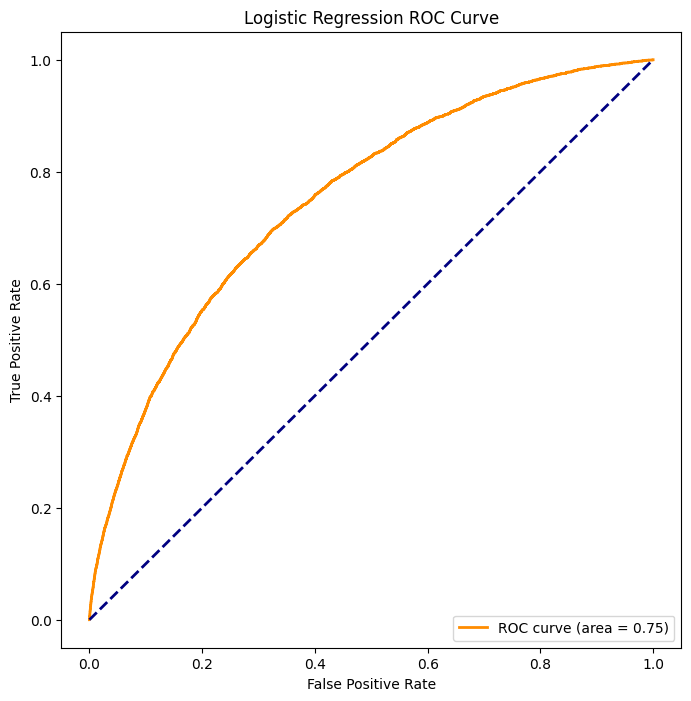

In [75]:
# Generate ROC curve
fpr, tpr, _ = roc_curve(y_validate, log_reg_predict_proba)
roc_auc_curve = auc(fpr, tpr)

# Plotting ROC curve
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc_curve))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression ROC Curve')
plt.legend(loc='lower right')
plt.show()

**Random Forest & K-Fold Cross Validation**

In [76]:
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, precision_score
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

In [77]:
# Stratified KFold Random Forest

# Initializing the Random Forest classifier with tuned hyperparameters
rf_tuned_classifier = RandomForestClassifier(
    n_estimators=120,
    max_depth=8,
    min_samples_split=10,
    min_samples_leaf=5,
    max_features=0.5,
    random_state=42,
    n_jobs=-1
)

n_splits = 5

# Initializing StratifiedKFold
kf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Lists to store evaluation metrics for each fold
accuracy_scores = []
roc_auc_scores = []
f1_scores = []
precision_scores = []

# Lists to store ROC curve data for each fold
all_fpr = []
all_tpr = []

# Performing K-Fold cross-validation
for fold, (train_index, val_index) in enumerate(kf.split(X_train, y_train)):
    print(f"Training fold {fold + 1}/{n_splits}")

    X_train_fold, X_val_fold = X_train.iloc[train_index], X_train.iloc[val_index]
    y_train_fold, y_val_fold = y_train.iloc[train_index], y_train.iloc[val_index]

    # Training the Random Forest classifier on the training fold
    rf_tuned_classifier.fit(X_train_fold, y_train_fold)

    # Predicting probabilities on the validation fold
    y_pred_val_proba = rf_tuned_classifier.predict_proba(X_val_fold)[:, 1]

    # Evaluating accuracy and ROC AUC for this fold
    accuracy = accuracy_score(y_val_fold, (y_pred_val_proba > 0.5).astype(int))
    roc_auc = roc_auc_score(y_val_fold, y_pred_val_proba)
    f1 = f1_score(y_val_fold, (y_pred_val_proba > 0.5).astype(int))
    precision = precision_score(y_val_fold, (y_pred_val_proba > 0.5).astype(int))

    # Printing accuracy and AUC scores for this fold
    print(f"Fold {fold + 1} - Accuracy: {accuracy:.6f}, Valid AUC: {roc_auc:.6f}, F1 Score: {f1:.6f}, Precision: {precision:.6f}")

    # Appending the scores to the lists
    accuracy_scores.append(accuracy)
    roc_auc_scores.append(roc_auc)
    f1_scores.append(f1)
    precision_scores.append(precision)

    # Calculating ROC curve for this fold
    fpr, tpr, _ = roc_curve(y_val_fold, y_pred_val_proba)
    all_fpr.append(fpr)
    all_tpr.append(tpr)

# Printing the average scores across all folds
print("Average Accuracy:", np.mean(accuracy_scores))
print("Average ROC AUC:", np.mean(roc_auc_scores))
print("Average F1 Score:", np.mean(f1_scores))
print("Average Precision:", np.mean(precision_scores))

Training fold 1/5
Fold 1 - Accuracy: 0.919231, Valid AUC: 0.737320, F1 Score: 0.000503, Precision: 1.000000
Training fold 2/5
Fold 2 - Accuracy: 0.919292, Valid AUC: 0.739354, F1 Score: 0.003013, Precision: 0.750000
Training fold 3/5
Fold 3 - Accuracy: 0.919109, Valid AUC: 0.737665, F1 Score: 0.001004, Precision: 0.250000
Training fold 4/5
Fold 4 - Accuracy: 0.919250, Valid AUC: 0.731489, F1 Score: 0.003011, Precision: 0.600000
Training fold 5/5
Fold 5 - Accuracy: 0.919290, Valid AUC: 0.731094, F1 Score: 0.008984, Precision: 0.562500
Average Accuracy: 0.9192343341322186
Average ROC AUC: 0.7353845123195828
Average F1 Score: 0.003303081690467452
Average Precision: 0.6325000000000001


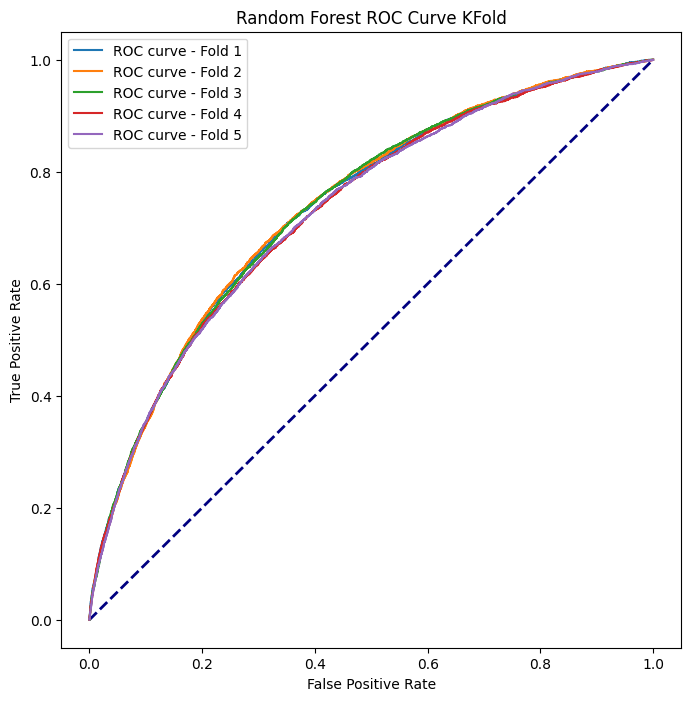

In [78]:
# Plot ROC curve for the Random Forest KFold
plt.figure(figsize=(8, 8))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
for i in range(n_splits):
    plt.plot(all_fpr[i], all_tpr[i], label=f'ROC curve - Fold {i + 1}')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC Curve KFold')
plt.legend()
plt.show()

In [79]:
# Training the Random Forest model over the complete train set

# Initializing the Random Forest classifier with tuned hyperparameters
rf_tuned_classifier = RandomForestClassifier(
    n_estimators=120,
    max_depth=8,
    min_samples_split=10,
    min_samples_leaf=5,
    max_features=0.5,
    random_state=42,
    n_jobs=-1
)

# Training the Random Forest classifier on the training set
rf_tuned_classifier.fit(X_train, y_train)

# Prediction on the validation set
y_pred_val = rf_tuned_classifier.predict(X_validate)

# Test data results
accuracy_val = accuracy_score(y_validate, (y_pred_val> 0.5).astype(int))
roc_auc_val = roc_auc_score(y_validate, y_pred_val)
f1_val = f1_score(y_validate, (y_pred_val> 0.5).astype(int))
precision_val = precision_score(y_validate, (y_pred_val> 0.5).astype(int))

# Printing scores for the validation set
print("Validation Set Metrics:")
print("Accuracy:", accuracy_val)
print("ROC AUC:", roc_auc_val)
print("F1 Score:", f1_val)
print("Precision:", precision_val)

Validation Set Metrics:
Accuracy: 0.9195323805342829
ROC AUC: 0.5004609470180021
F1 Score: 0.0020165355918531965
Precision: 0.5


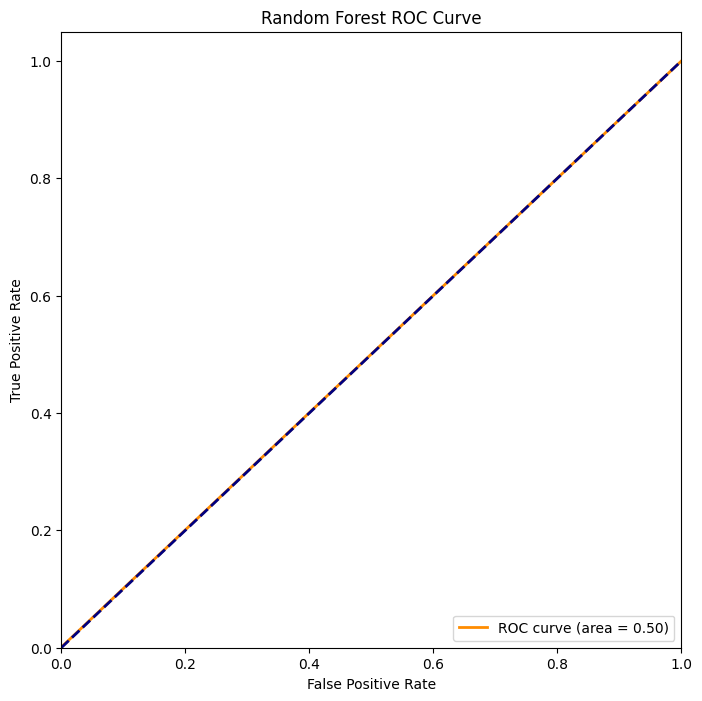

In [80]:
# Compute ROC curve
fpr, tpr, _ = roc_curve(y_validate, y_pred_val)
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC Curve')
plt.legend(loc='lower right')
plt.show()

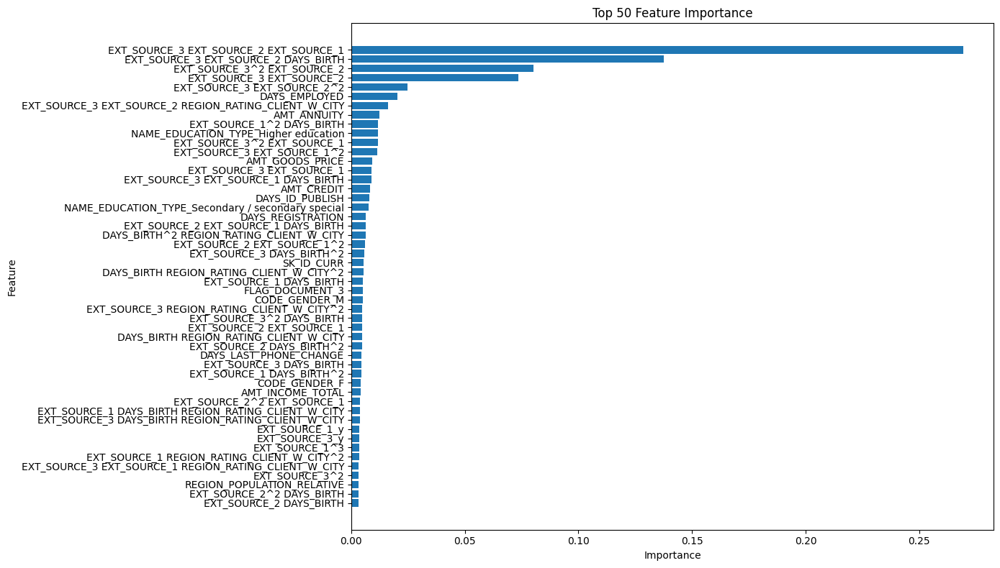

In [81]:
import matplotlib.pyplot as plt

feature_importances = rf_tuned_classifier.feature_importances_

# Create a DataFrame to hold the feature names and their importance scores
feature_importance_df = pd.DataFrame({
    'Feature': df_train.columns,
    'Importance': feature_importances
})

# Sort features by importance
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=True).tail(50)
top_features = feature_importance_df['Feature'].tolist()

# Plot feature importance
plt.figure(figsize=(14, 8))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Top 50 Feature Importance')
plt.tight_layout()
plt.show()

In [82]:
print(top_features)

['EXT_SOURCE_2 DAYS_BIRTH', 'EXT_SOURCE_2^2 DAYS_BIRTH', 'REGION_POPULATION_RELATIVE', 'EXT_SOURCE_3^2', 'EXT_SOURCE_3 EXT_SOURCE_1 REGION_RATING_CLIENT_W_CITY', 'EXT_SOURCE_1 REGION_RATING_CLIENT_W_CITY^2', 'EXT_SOURCE_1^3', 'EXT_SOURCE_3_y', 'EXT_SOURCE_1_y', 'EXT_SOURCE_3 DAYS_BIRTH REGION_RATING_CLIENT_W_CITY', 'EXT_SOURCE_1 DAYS_BIRTH REGION_RATING_CLIENT_W_CITY', 'EXT_SOURCE_2^2 EXT_SOURCE_1', 'AMT_INCOME_TOTAL', 'CODE_GENDER_F', 'EXT_SOURCE_1 DAYS_BIRTH^2', 'EXT_SOURCE_3 DAYS_BIRTH', 'DAYS_LAST_PHONE_CHANGE', 'EXT_SOURCE_2 DAYS_BIRTH^2', 'DAYS_BIRTH REGION_RATING_CLIENT_W_CITY', 'EXT_SOURCE_2 EXT_SOURCE_1', 'EXT_SOURCE_3^2 DAYS_BIRTH', 'EXT_SOURCE_3 REGION_RATING_CLIENT_W_CITY^2', 'CODE_GENDER_M', 'FLAG_DOCUMENT_3', 'EXT_SOURCE_1 DAYS_BIRTH', 'DAYS_BIRTH REGION_RATING_CLIENT_W_CITY^2', 'SK_ID_CURR', 'EXT_SOURCE_3 DAYS_BIRTH^2', 'EXT_SOURCE_2 EXT_SOURCE_1^2', 'DAYS_BIRTH^2 REGION_RATING_CLIENT_W_CITY', 'EXT_SOURCE_2 EXT_SOURCE_1 DAYS_BIRTH', 'DAYS_REGISTRATION', 'NAME_EDUCATION_T

**LightGBM & K-Fold Cross Validation**

In [83]:
import lightgbm as lgb
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, f1_score, precision_score, roc_curve, auc
from sklearn.model_selection import train_test_split, StratifiedKFold, KFold
import matplotlib.pyplot as plt
import time
import warnings

Training with all Feature Engineered Data

In [84]:
import re
application_train = application_train.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [85]:
# Check if features exist in the DataFrame
missing_features = [feature for feature in top_features if feature not in df_train.columns]

# Print missing features
if missing_features:
    print("The following features are missing:")
    print(missing_features)
else:
    print("All features are present in the dataset.")

All features are present in the dataset.


In [86]:
X = application_train.drop(['SK_ID_CURR', 'TARGET'], axis=1)
Y = application_train['TARGET']

In [87]:
X_train, X_valid, y_train, y_valid = train_test_split(X, Y, test_size=0.20, random_state=24)

In [88]:
params = {
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'binary',
    'metric': 'auc',
    'learning_rate': 0.01,
    'num_leaves': 48,
    'num_boost_round': 5000,
    'verbose': -1,
    'colsample_bytree': 0.8,
    'subsample': 0.9,
    'max_depth': 7,
    'reg_alpha': 0.1,
    'reg_lambda': 0.1,
    'min_split_gain': 0.01,
    'min_child_weight': 1,
    'force_row_wise' : True,
}

# Defining callbacks for early stopping and logging
callbacks = [
    lgb.early_stopping(100),  
    lgb.log_evaluation(period=100)  
]

# number of folds for Stratified K-fold cross-validation
num_folds = 5
num_round = 1000

# Initializing StratifiedKFold
skf = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=24)

# Ignore all warnings
warnings.filterwarnings("ignore")

# Lists to store evaluation metrics for each fold
validation_scores = []
train_scores = []
f1_scores = []
precision_scores = []
roc_auc_scores = []

# Lists to store evaluation metrics for each fold
all_fpr = []
all_tpr = []
mean_fpr = np.linspace(0, 1, 100)

# Iterating over each fold
for fold, (train_idx, valid_idx) in enumerate(skf.split(X_train, y_train)):
    print(f"Training fold {fold + 1}/{num_folds}")

    # Split the data into training and validation sets for this fold
    X_train_fold, X_valid_fold = X_train.iloc[train_idx], X_train.iloc[valid_idx]
    y_train_fold, y_valid_fold = y_train.iloc[train_idx], y_train.iloc[valid_idx]

    # Defining training and validation datasets
    train_data_fold = lgb.Dataset(X_train_fold, y_train_fold)
    valid_data_fold = lgb.Dataset(X_valid_fold, y_valid_fold)

    # Training the model
    lgb_model = lgb.train(
        params,
        train_data_fold,
        num_round,
        valid_sets=[train_data_fold, valid_data_fold],
        callbacks=callbacks
    )

    # Predicting on the validation set for this fold
    y_pred_val = lgb_model.predict(X_valid_fold, num_iteration=lgb_model.best_iteration)

    # Converting probabilities to binary predictions using a threshold of 0.5
    y_pred_binary = (y_pred_val > 0.5).astype(int)

    # Evaluating on the validation set for this fold
    train_score = lgb_model.best_score["training"]["auc"]
    validation_score = lgb_model.best_score["valid_1"]["auc"]
    f1 = f1_score(y_valid_fold, y_pred_binary)
    precision = precision_score(y_valid_fold, y_pred_binary)

    # Calculating ROC curve
    fpr, tpr, _ = roc_curve(y_valid_fold, y_pred_val)
    roc_auc = auc(fpr, tpr)

    # Appending scores to lists
    train_scores.append(train_score)
    validation_scores.append(validation_score)
    f1_scores.append(f1)
    precision_scores.append(precision)
    roc_auc_scores.append(roc_auc)

    print(f"Fold {fold + 1} - Train AUC: {train_score:.6f}, Valid AUC: {validation_score:.6f}, F1 Score: {f1:.6f}, Precision: {precision:.6f}")

    # Storing the true positive rates
    fpr, tpr, _ = roc_curve(y_valid_fold, y_pred_val)
    all_fpr.append(fpr)
    all_tpr.append(tpr)

# Calculating the mean validation score across all folds
mean_validation_score = np.mean(validation_scores)
print(f"Mean validation AUC: {mean_validation_score}")
mean_train_score = np.mean(train_scores)
mean_validation_score = np.mean(validation_scores)

# Creating a DataFrame to display the results
results_df = pd.DataFrame({
    'fold': np.arange(num_folds),
    'train': train_scores,
    'valid': validation_scores,
    'f1': f1_scores,
    'precision': precision_scores,
    'roc_auc': roc_auc_scores
})

# Adding the overall row
results_df.loc[num_folds] = ['overall', mean_train_score, mean_validation_score, np.mean(f1_scores), np.mean(precision_scores), np.mean(roc_auc_scores)]

print(results_df)

# Reset warning filters to default
warnings.filterwarnings("default")

Training fold 1/5
Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.75427	valid_1's auc: 0.736401
[200]	training's auc: 0.767602	valid_1's auc: 0.742739
[300]	training's auc: 0.779537	valid_1's auc: 0.747849
[400]	training's auc: 0.78963	valid_1's auc: 0.751209
[500]	training's auc: 0.798252	valid_1's auc: 0.753417
[600]	training's auc: 0.805877	valid_1's auc: 0.754977
[700]	training's auc: 0.812652	valid_1's auc: 0.755876
[800]	training's auc: 0.818997	valid_1's auc: 0.756416
[900]	training's auc: 0.824768	valid_1's auc: 0.756899
[1000]	training's auc: 0.830272	valid_1's auc: 0.757257
[1100]	training's auc: 0.835467	valid_1's auc: 0.757393
[1200]	training's auc: 0.84069	valid_1's auc: 0.757458
[1300]	training's auc: 0.845494	valid_1's auc: 0.757632
[1400]	training's auc: 0.850036	valid_1's auc: 0.75775
[1500]	training's auc: 0.854465	valid_1's auc: 0.757851
[1600]	training's auc: 0.858788	valid_1's auc: 0.757902
[1700]	training's auc: 0.862648	valid

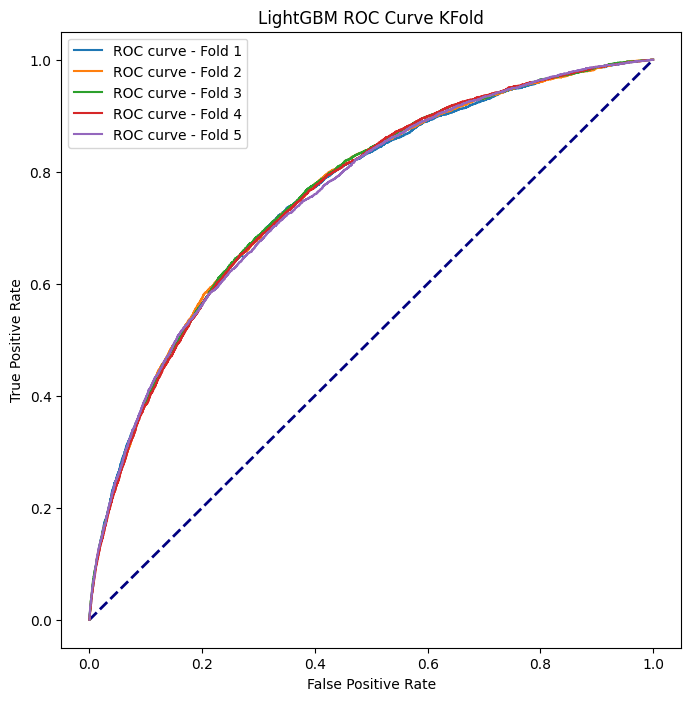

In [89]:
# Plot LightGBM ROC curve 
plt.figure(figsize=(8, 8))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
for i in range(num_folds):
    plt.plot(all_fpr[i], all_tpr[i], label=f'ROC curve - Fold {i + 1}')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('LightGBM ROC Curve KFold')
plt.legend()
plt.show()

In [90]:
# Training the model on the whole train set
# Ignore all warnings
warnings.filterwarnings("ignore")

params = {
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'binary',
    'metric': 'auc',
    'learning_rate': 0.01,
    'num_leaves': 48,
    'num_boost_round': 5000,
    'verbose': -1,
    'colsample_bytree': 0.8,
    'subsample': 0.9,
    'max_depth': 7,
    'reg_alpha': 0.1,
    'reg_lambda': 0.1,
    'min_split_gain': 0.01,
    'min_child_weight': 1,
    'force_row_wise' : True,
}

# Define training and validation datasets
train_data = lgb.Dataset(X_train, y_train)
valid_data = lgb.Dataset(X_valid, y_valid)

# Define callbacks for early stopping and logging
callbacks = [
    lgb.early_stopping(100),  
    lgb.log_evaluation(period=100)  
]

# Training the model
num_round = 1000
model = lgb.train(
    params,
    train_set = train_data,
    valid_sets=[train_data, valid_data],
    callbacks=callbacks
)

# Reset warning filters to default
warnings.filterwarnings("default")

Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.751199	valid_1's auc: 0.736671
[200]	training's auc: 0.763243	valid_1's auc: 0.742958
[300]	training's auc: 0.773771	valid_1's auc: 0.748043
[400]	training's auc: 0.782652	valid_1's auc: 0.751422
[500]	training's auc: 0.790365	valid_1's auc: 0.7535
[600]	training's auc: 0.797106	valid_1's auc: 0.754689
[700]	training's auc: 0.803294	valid_1's auc: 0.755489
[800]	training's auc: 0.809291	valid_1's auc: 0.756206
[900]	training's auc: 0.814606	valid_1's auc: 0.756567
[1000]	training's auc: 0.819771	valid_1's auc: 0.756872
[1100]	training's auc: 0.824523	valid_1's auc: 0.757189
[1200]	training's auc: 0.829157	valid_1's auc: 0.757404
[1300]	training's auc: 0.833475	valid_1's auc: 0.757569
[1400]	training's auc: 0.83764	valid_1's auc: 0.757635
[1500]	training's auc: 0.842	valid_1's auc: 0.757672
[1600]	training's auc: 0.846015	valid_1's auc: 0.75769
[1700]	training's auc: 0.849849	valid_1's auc: 0.757786
[1

In [91]:
# Predicting on the validation set
y_pred_val = model.predict(X_valid, num_iteration=model.best_iteration)

# Converting probabilities to binary predictions using a threshold of 0.5
y_pred_binary = (y_pred_val > 0.5).astype(int)

# Evaluating on the validation set
accuracy = accuracy_score(y_valid, y_pred_binary)
f1 = f1_score(y_valid, y_pred_binary)
precision = precision_score(y_valid, y_pred_binary)

# Calculating ROC curve for the validation set
fpr, tpr, _ = roc_curve(y_valid, y_pred_val)
roc_auc = auc(fpr, tpr)

# Printing evaluation metrics
print(f"Accuracy: {accuracy:.6f}")
print(f"F1 Score: {f1:.6f}")
print(f"Precision: {precision:.6f}")
print(f"ROC AUC: {roc_auc:.6f}")

Accuracy: 0.919354
F1 Score: 0.033138
Precision: 0.594406
ROC AUC: 0.757813


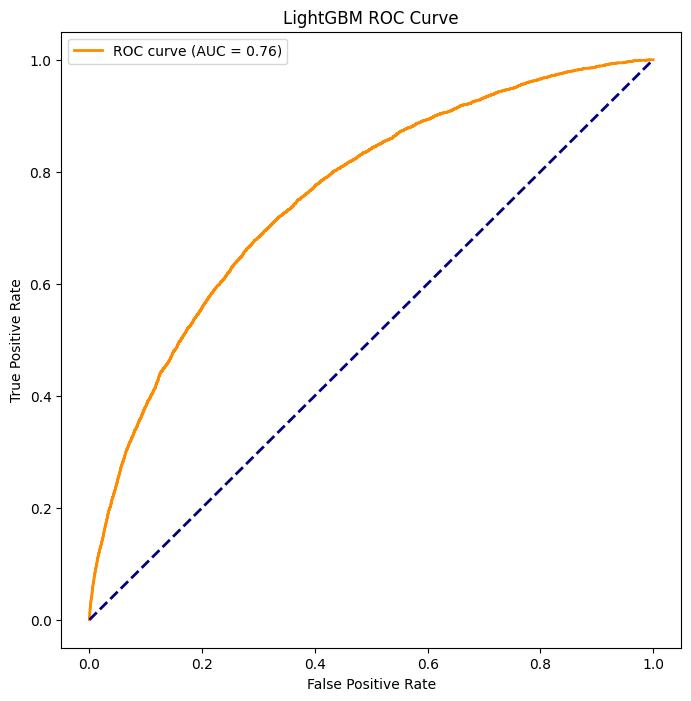

In [92]:
# Plot LightGBM ROC curve for the validation set
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('LightGBM ROC Curve')
plt.legend()
plt.show()

Using top 50 features alone

In [93]:
X = df_train[top_features]
Y = target

In [94]:
X_train, X_valid, y_train, y_valid = train_test_split(X, Y, test_size=0.20, random_state=24)

In [95]:
params = {
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'binary',
    'metric': 'auc',
    'learning_rate': 0.01,
    'num_leaves': 48,
    'num_boost_round': 5000,
    'verbose': -1,
    'colsample_bytree': 0.8,
    'subsample': 0.9,
    'max_depth': 7,
    'reg_alpha': 0.1,
    'reg_lambda': 0.1,
    'min_split_gain': 0.01,
    'min_child_weight': 1,
    'force_row_wise' : True,
}


# number of folds for Stratified K-fold cross-validation
num_folds = 5
num_round = 1000

# Initialize StratifiedKFold
skf = StratifiedKFold(n_splits=num_folds, shuffle=True, random_state=24)

# Ignore all warnings
warnings.filterwarnings("ignore")

# Lists to store evaluation metrics for each fold
validation_scores = []
train_scores = []
f1_scores = []
precision_scores = []
roc_auc_scores = []

# Lists to store ROC curve data for each fold
all_fpr = []
all_tpr = []
mean_fpr = np.linspace(0, 1, 100)

# Iterating over each fold
for fold, (train_idx, valid_idx) in enumerate(skf.split(X_train, y_train)):
    print(f"Training fold {fold + 1}/{num_folds}")

    # Splitting the data into training and validation sets for this fold
    X_train_fold, X_valid_fold = X_train.iloc[train_idx], X_train.iloc[valid_idx]
    y_train_fold, y_valid_fold = y_train.iloc[train_idx], y_train.iloc[valid_idx]

    # Defining training and validation datasets
    train_data_fold = lgb.Dataset(X_train_fold, y_train_fold)
    valid_data_fold = lgb.Dataset(X_valid_fold, y_valid_fold)

    # Training the model
    lgb_model = lgb.train(
        params,
        train_data_fold,
        num_round,
        valid_sets=[train_data_fold, valid_data_fold],
        callbacks=callbacks
    )

    # Predicting on the validation set for this fold
    y_pred_val = lgb_model.predict(X_valid_fold, num_iteration=lgb_model.best_iteration)

    # Converting probabilities to binary predictions using a threshold of 0.5
    y_pred_binary = (y_pred_val > 0.5).astype(int)

    # Evaluating on the validation set for this fold
    train_score = lgb_model.best_score["training"]["auc"]
    validation_score = lgb_model.best_score["valid_1"]["auc"]
    f1 = f1_score(y_valid_fold, y_pred_binary)
    precision = precision_score(y_valid_fold, y_pred_binary)

    # Calculating ROC curve
    fpr, tpr, _ = roc_curve(y_valid_fold, y_pred_val)
    roc_auc = auc(fpr, tpr)

    # Appending scores to lists
    train_scores.append(train_score)
    validation_scores.append(validation_score)
    f1_scores.append(f1)
    precision_scores.append(precision)
    roc_auc_scores.append(roc_auc)

    print(f"Fold {fold + 1} - Train AUC: {train_score:.6f}, Valid AUC: {validation_score:.6f}, F1 Score: {f1:.6f}, Precision: {precision:.6f}")

    # Storing the true positive rates 
    fpr, tpr, _ = roc_curve(y_valid_fold, y_pred_val)
    all_fpr.append(fpr)
    all_tpr.append(tpr)

# Calculating the mean validation score across all folds
mean_validation_score = np.mean(validation_scores)
print(f"Mean validation AUC: {mean_validation_score}")
mean_train_score = np.mean(train_scores)
mean_validation_score = np.mean(validation_scores)

# Creating a DataFrame to display the results
results_df = pd.DataFrame({
    'fold': np.arange(num_folds),
    'train': train_scores,
    'valid': validation_scores,
    'f1': f1_scores,
    'precision': precision_scores,
    'roc_auc': roc_auc_scores
})

# Adding the overall row
results_df.loc[num_folds] = ['overall', mean_train_score, mean_validation_score, np.mean(f1_scores), np.mean(precision_scores), np.mean(roc_auc_scores)]

print(results_df)

# Reset warning filters to default
warnings.filterwarnings("default")

Training fold 1/5
[100]	training's auc: 0.752395	valid_1's auc: 0.735677
[200]	training's auc: 0.763784	valid_1's auc: 0.741421
[300]	training's auc: 0.773971	valid_1's auc: 0.745543
[400]	training's auc: 0.782855	valid_1's auc: 0.748458
[500]	training's auc: 0.790915	valid_1's auc: 0.750112
[600]	training's auc: 0.798003	valid_1's auc: 0.751334
[700]	training's auc: 0.804547	valid_1's auc: 0.751941
[800]	training's auc: 0.81059	valid_1's auc: 0.752384
[900]	training's auc: 0.816209	valid_1's auc: 0.753031
[1000]	training's auc: 0.82152	valid_1's auc: 0.753445
[1100]	training's auc: 0.82675	valid_1's auc: 0.75352
[1200]	training's auc: 0.831829	valid_1's auc: 0.753625
[1300]	training's auc: 0.836663	valid_1's auc: 0.75347
[1400]	training's auc: 0.841205	valid_1's auc: 0.753393
[1500]	training's auc: 0.845813	valid_1's auc: 0.75317
[1600]	training's auc: 0.850036	valid_1's auc: 0.753058
[1700]	training's auc: 0.854077	valid_1's auc: 0.753124
[1800]	training's auc: 0.857946	valid_1's auc

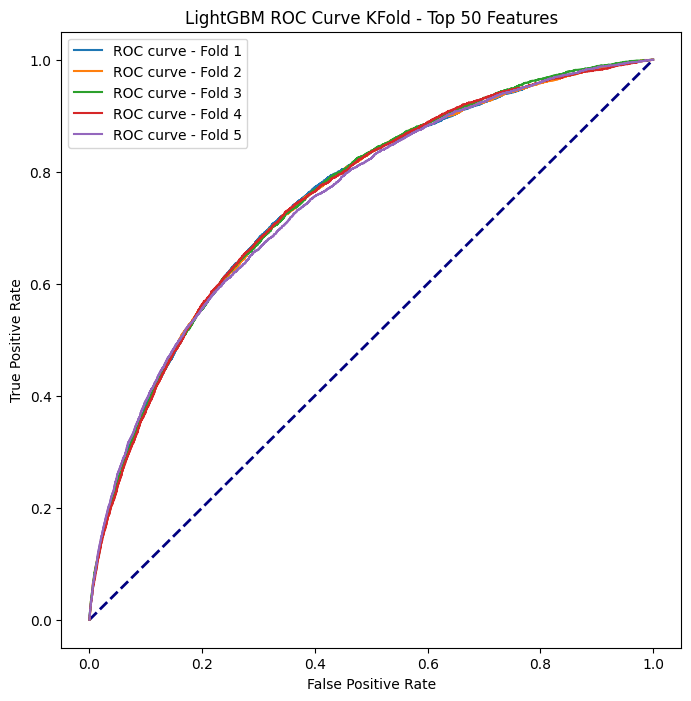

In [96]:
# Plot LightGBM ROC curve - Top 50 Features
plt.figure(figsize=(8, 8))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
for i in range(num_folds):
    plt.plot(all_fpr[i], all_tpr[i], label=f'ROC curve - Fold {i + 1}')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('LightGBM ROC Curve KFold - Top 50 Features')
plt.legend()
plt.show()

In [97]:
# Training the model on the whole top 50 features train set
# Ignore all warnings
warnings.filterwarnings("ignore")

params = {
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'binary',
    'metric': 'auc',
    'learning_rate': 0.01,
    'num_leaves': 48,
    'num_boost_round': 5000,
    'verbose': -1,
    'colsample_bytree': 0.8,
    'subsample': 0.9,
    'max_depth': 7,
    'reg_alpha': 0.1,
    'reg_lambda': 0.1,
    'min_split_gain': 0.01,
    'min_child_weight': 1,
    'force_row_wise' : True,
}

# Defining training and validation datasets
train_data = lgb.Dataset(X_train, y_train)
valid_data = lgb.Dataset(X_valid, y_valid)

# Defining callbacks for early stopping and logging
callbacks = [
    lgb.early_stopping(100),  
    lgb.log_evaluation(period=100)  ]

# Training the model
num_round = 1000
model = lgb.train(
    params,
    train_set = train_data,
    valid_sets=[train_data, valid_data],
    callbacks=callbacks
)

# Reset warning filters to default
warnings.filterwarnings("default")

Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.749854	valid_1's auc: 0.735943
[200]	training's auc: 0.759955	valid_1's auc: 0.741093
[300]	training's auc: 0.768799	valid_1's auc: 0.744766
[400]	training's auc: 0.776779	valid_1's auc: 0.747579
[500]	training's auc: 0.783655	valid_1's auc: 0.749233
[600]	training's auc: 0.789937	valid_1's auc: 0.750204
[700]	training's auc: 0.795494	valid_1's auc: 0.750673
[800]	training's auc: 0.800787	valid_1's auc: 0.751134
[900]	training's auc: 0.805755	valid_1's auc: 0.751279
[1000]	training's auc: 0.810601	valid_1's auc: 0.751339
[1100]	training's auc: 0.815295	valid_1's auc: 0.751411
[1200]	training's auc: 0.819566	valid_1's auc: 0.751422
[1300]	training's auc: 0.823673	valid_1's auc: 0.751398
Early stopping, best iteration is:
[1207]	training's auc: 0.819851	valid_1's auc: 0.75144


In [98]:
# Predicting on the validation set
y_pred_val = model.predict(X_valid, num_iteration=model.best_iteration)

# Converting probabilities to binary predictions using a threshold of 0.5
y_pred_binary = (y_pred_val > 0.5).astype(int)

# Evaluating on the validation set
accuracy = accuracy_score(y_valid, y_pred_binary)
f1 = f1_score(y_valid, y_pred_binary)
precision = precision_score(y_valid, y_pred_binary)

# Calculating ROC curve for the validation set
fpr, tpr, _ = roc_curve(y_valid, y_pred_val)
roc_auc = auc(fpr, tpr)

# Printing evaluation metrics
print(f"Accuracy: {accuracy:.6f}")
print(f"F1 Score: {f1:.6f}")
print(f"Precision: {precision:.6f}")
print(f"ROC AUC: {roc_auc:.6f}")

Accuracy: 0.919045
F1 Score: 0.023534
Precision: 0.535714
ROC AUC: 0.751440


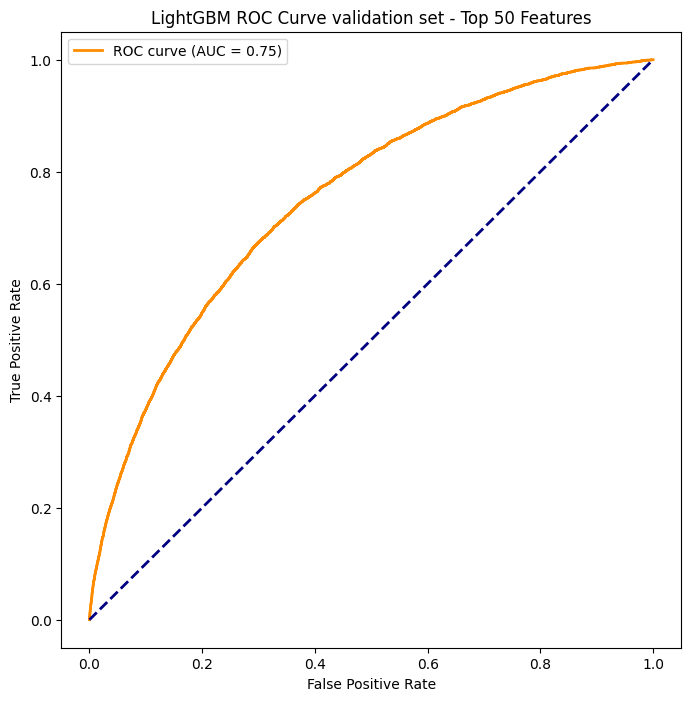

In [99]:
# Plot LightGBM ROC curve for the validation set - Top 50 Features
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('LightGBM ROC Curve validation set - Top 50 Features')
plt.legend()
plt.show()

**XGBoost & k-Fold Cross Validation**

In [100]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
import warnings

In [101]:
# Using Top 50 fetaures
X = df_train[top_features]
Y = target

In [102]:
X_train, X_valid, y_train, y_valid = train_test_split(X, Y, test_size=0.20, random_state=24)

In [103]:
# Ignore all warnings
warnings.filterwarnings("ignore")

# Define the XGBoost model
xgb_model = XGBClassifier(
    objective='binary:logistic',
    max_depth=4,
    learning_rate=0.01,
    n_estimators=1000,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_lambda=1,
    reg_alpha=0,
    seed=0,
    num_parallel_tree=1,
    min_child_weight=1,
    eval_metric='auc',
    n_jobs= -1
)

# Defining k-fold cross-validation
k_folds = 5
kf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

# Lists to store evaluation metrics for each fold
accuracy_scores = []
roc_auc_scores = []
f1_scores = []
precision_scores = []

# Lists to store results for each fold
fold_numbers = []
train_scores = []
valid_scores = []

# Lists to store ROC curve data for each fold
all_fpr = []
all_tpr = []

# Performing k-fold cross-validation
for fold, (train_idx, valid_idx) in enumerate(skf.split(X_train, y_train)):
    print(f"Training fold {fold + 1}/{num_folds}")

    X_train_fold, X_valid_fold = X_train.iloc[train_idx], X_train.iloc[valid_idx]
    y_train_fold, y_valid_fold = y_train.iloc[train_idx], y_train.iloc[valid_idx]

    # Training the model
    xgb_model.fit(X_train_fold, y_train_fold)

    # Making predictions on the validation set
    y_valid_pred = xgb_model.predict_proba(X_valid_fold)[:, 1]

    # Evaluating the model
    accuracy = accuracy_score(y_valid_fold, (y_valid_pred > 0.5).astype(int))
    roc_auc = roc_auc_score(y_valid_fold, y_valid_pred)
    f1 = f1_score(y_valid_fold, (y_valid_pred > 0.5).astype(int))
    precision = precision_score(y_valid_fold, (y_valid_pred > 0.5).astype(int))

    accuracy_scores.append(accuracy)
    roc_auc_scores.append(roc_auc)
    f1_scores.append(f1)
    precision_scores.append(precision)

    # Storing results for each fold
    fold_numbers.append(fold + 1)
    train_scores.append(accuracy)
    valid_scores.append(roc_auc)

    print(f"Fold {fold + 1} - Accuracy: {accuracy:.4f}, ROC AUC: {roc_auc:.4f}, F1 Score: {f1:.4f}, Precision: {precision:.4f}")

    # Calculating ROC curve
    fpr, tpr, _ = roc_curve(y_valid_fold, y_valid_pred)
    all_fpr.append(fpr)
    all_tpr.append(tpr)

# Displaying average performance metrics across all folds
average_accuracy = np.mean(accuracy_scores)
average_roc_auc = np.mean(roc_auc_scores)
average_f1 = np.mean(f1_scores)
average_precision = np.mean(precision_scores)

print(f'Average Accuracy: {average_accuracy:.4f}')
print(f'Average ROC AUC: {average_roc_auc:.4f}')
print(f'Average F1 Score: {average_f1:.4f}')
print(f'Average Precision: {average_precision:.4f}')

# Creating a results dataframe
results_df = pd.DataFrame({
    'Fold': fold_numbers,
    'Train_Accuracy': train_scores,
    'Valid_ROC_AUC': valid_scores,
    'F1_Score': f1_scores,
    'Precision': precision_scores
})

# Adding an overall row to the dataframe
results_df.loc[num_folds] = ['Overall', average_accuracy, average_roc_auc, average_f1, average_precision]

print(results_df)

# Reset warning filters to default
warnings.filterwarnings("default")

Training fold 1/5
Fold 1 - Accuracy: 0.9196, ROC AUC: 0.7514, F1 Score: 0.0125, Precision: 0.6757
Training fold 2/5
Fold 2 - Accuracy: 0.9193, ROC AUC: 0.7524, F1 Score: 0.0119, Precision: 0.4800
Training fold 3/5
Fold 3 - Accuracy: 0.9194, ROC AUC: 0.7541, F1 Score: 0.0139, Precision: 0.5185
Training fold 4/5
Fold 4 - Accuracy: 0.9195, ROC AUC: 0.7537, F1 Score: 0.0144, Precision: 0.5577
Training fold 5/5
Fold 5 - Accuracy: 0.9196, ROC AUC: 0.7513, F1 Score: 0.0120, Precision: 0.6857
Average Accuracy: 0.9195
Average ROC AUC: 0.7526
Average F1 Score: 0.0130
Average Precision: 0.5835
      Fold  Train_Accuracy  Valid_ROC_AUC  F1_Score  Precision
0        1        0.919617       0.751360  0.012484   0.675676
1        2        0.919312       0.752403  0.011946   0.480000
2        3        0.919394       0.754140  0.013923   0.518519
3        4        0.919494       0.753696  0.014431   0.557692
4        5        0.919636       0.751349  0.011994   0.685714
5  Overall        0.919490      

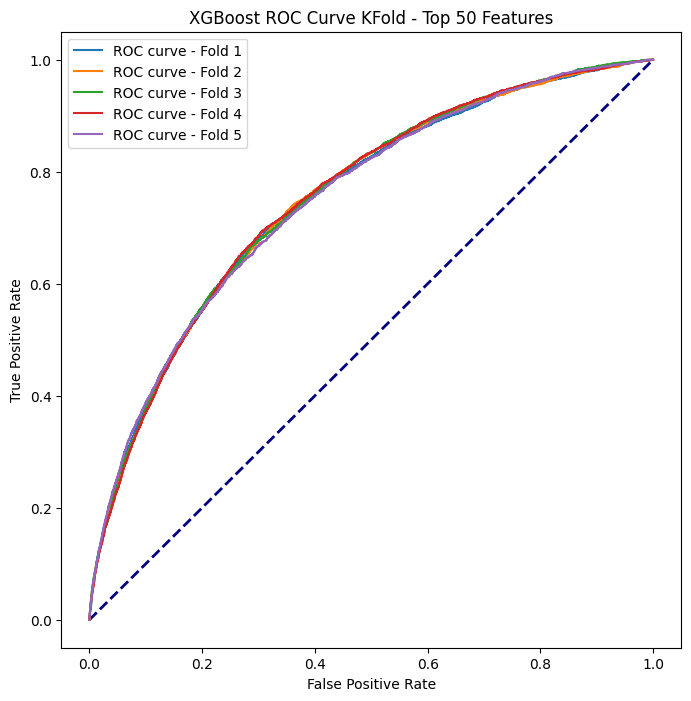

In [104]:
# Plotting ROC curve for each fold - Top 50 Features
plt.figure(figsize=(8, 8))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
for i in range(num_folds):
    plt.plot(all_fpr[i], all_tpr[i], label=f'ROC curve - Fold {i + 1}')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost ROC Curve KFold - Top 50 Features')
plt.legend()
plt.show()

In [105]:
# Defining the XGBoost model
xgb_model = XGBClassifier(
    objective='binary:logistic',
    max_depth=4,
    learning_rate=0.01,
    n_estimators=1000,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_lambda=1,
    reg_alpha=0,
    seed=0,
    num_parallel_tree=1,
    min_child_weight=1,
    eval_metric='auc',
    n_jobs=-1
)

# Training the XGBoost model on the whole training set
xgb_model.fit(X_train, y_train)

# Make predictions on the validation set
y_valid_pred = xgb_model.predict_proba(X_valid)[:, 1]

# Converting probabilities to binary predictions using a threshold of 0.5
y_pred_binary = (y_valid_pred > 0.5).astype(int)

# Evaluating on the validation set
accuracy = accuracy_score(y_valid, y_pred_binary)
f1 = f1_score(y_valid, y_pred_binary)
precision = precision_score(y_valid, y_pred_binary)

# Calculating ROC curve for the validation set
fpr, tpr, _ = roc_curve(y_valid, y_valid_pred)
roc_auc_curve = auc(fpr, tpr)

# Print evaluation metrics
print(f"Accuracy: {accuracy:.6f}")
print(f"F1 Score: {f1:.6f}")
print(f"Precision: {precision:.6f}")
print(f"ROC AUC: {roc_auc_curve:.6f}")

Accuracy: 0.919077
F1 Score: 0.012696
Precision: 0.592593
ROC AUC: 0.749382


Validation ROC AUC: 0.7494


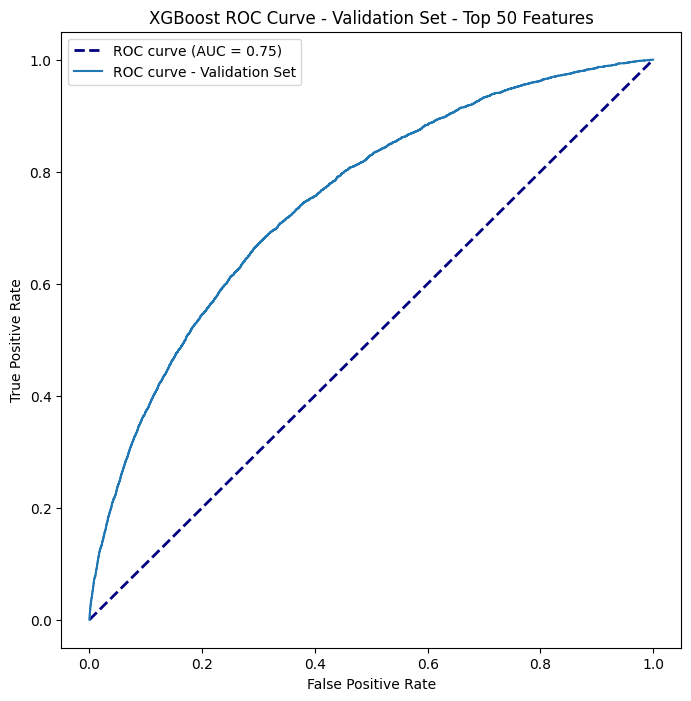

In [106]:
# Evaluating the model on the validation set
roc_auc = roc_auc_score(y_valid, y_valid_pred)

print(f'Validation ROC AUC: {roc_auc:.4f}')

# Plotting ROC curve for the validation set - Top 50 Features
fpr, tpr, _ = roc_curve(y_valid, y_valid_pred)
plt.figure(figsize=(8, 8))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot(fpr, tpr, label=f'ROC curve - Validation Set' )
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost ROC Curve - Validation Set - Top 50 Features')
plt.legend()
plt.show()

In [107]:
# Ignore all warnings
warnings.filterwarnings("ignore")

# Complete data XGBoost
X = df_train
Y = target

In [108]:
X_train, X_valid, y_train, y_valid = train_test_split(X, Y, test_size=0.20, random_state=24)

In [109]:
# Ignore all warnings
warnings.filterwarnings("ignore")

# Defining the XGBoost model
xgb_model = XGBClassifier(
    objective='binary:logistic',
    max_depth=4,
    learning_rate=0.01,
    n_estimators=1000,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_lambda=1,
    reg_alpha=0,
    seed=0,
    num_parallel_tree=1,
    min_child_weight=1,
    eval_metric='auc',
    n_jobs= -1
)

# Defining k-fold cross-validation
k_folds = 5
kf = StratifiedKFold(n_splits=k_folds, shuffle=True, random_state=42)

# Lists to store evaluation metrics for each fold
accuracy_scores = []
roc_auc_scores = []
f1_scores = []
precision_scores = []

# Lists to store results for each fold
fold_numbers = []
train_scores = []
valid_scores = []

# Lists to store ROC curve data for each fold
all_fpr = []
all_tpr = []

# Performing k-fold cross-validation
for fold, (train_idx, valid_idx) in enumerate(skf.split(X_train, y_train)):
    print(f"Training fold {fold + 1}/{num_folds}")

    X_train_fold, X_valid_fold = X_train.iloc[train_idx], X_train.iloc[valid_idx]
    y_train_fold, y_valid_fold = y_train.iloc[train_idx], y_train.iloc[valid_idx]

    # Training the model
    xgb_model.fit(X_train_fold, y_train_fold)

    # Making predictions on the validation set
    y_valid_pred = xgb_model.predict_proba(X_valid_fold)[:, 1]

    # Evaluating the model
    accuracy = accuracy_score(y_valid_fold, (y_valid_pred > 0.5).astype(int))
    roc_auc = roc_auc_score(y_valid_fold, y_valid_pred)
    f1 = f1_score(y_valid_fold, (y_valid_pred > 0.5).astype(int))
    precision = precision_score(y_valid_fold, (y_valid_pred > 0.5).astype(int))

    accuracy_scores.append(accuracy)
    roc_auc_scores.append(roc_auc)
    f1_scores.append(f1)
    precision_scores.append(precision)

    # Storing results for each fold
    fold_numbers.append(fold + 1)
    train_scores.append(accuracy)
    valid_scores.append(roc_auc)

    print(f"Fold {fold + 1} - Accuracy: {accuracy:.4f}, ROC AUC: {roc_auc:.4f}, F1 Score: {f1:.4f}, Precision: {precision:.4f}")

    # Calculating ROC curve
    fpr, tpr, _ = roc_curve(y_valid_fold, y_valid_pred)
    all_fpr.append(fpr)
    all_tpr.append(tpr)

# Displaying average performance metrics across all folds
average_accuracy = np.mean(accuracy_scores)
average_roc_auc = np.mean(roc_auc_scores)
average_f1 = np.mean(f1_scores)
average_precision = np.mean(precision_scores)

print(f'Average Accuracy: {average_accuracy:.4f}')
print(f'Average ROC AUC: {average_roc_auc:.4f}')
print(f'Average F1 Score: {average_f1:.4f}')
print(f'Average Precision: {average_precision:.4f}')

# Creating a results dataframe
results_df = pd.DataFrame({
    'Fold': fold_numbers,
    'Train_Accuracy': train_scores,
    'Valid_ROC_AUC': valid_scores,
    'F1_Score': f1_scores,
    'Precision': precision_scores
})

# Adding an overall row to the dataframe
results_df.loc[num_folds] = ['Overall', average_accuracy, average_roc_auc, average_f1, average_precision]

print(results_df)

# Reset warning filters to default
warnings.filterwarnings("default")

Training fold 1/5
Fold 1 - Accuracy: 0.9196, ROC AUC: 0.7538, F1 Score: 0.0115, Precision: 0.7188
Training fold 2/5
Fold 2 - Accuracy: 0.9193, ROC AUC: 0.7569, F1 Score: 0.0105, Precision: 0.4773
Training fold 3/5
Fold 3 - Accuracy: 0.9196, ROC AUC: 0.7571, F1 Score: 0.0154, Precision: 0.6200
Training fold 4/5
Fold 4 - Accuracy: 0.9196, ROC AUC: 0.7560, F1 Score: 0.0120, Precision: 0.6486
Training fold 5/5
Fold 5 - Accuracy: 0.9196, ROC AUC: 0.7558, F1 Score: 0.0100, Precision: 0.6897
Average Accuracy: 0.9195
Average ROC AUC: 0.7559
Average F1 Score: 0.0119
Average Precision: 0.6309
      Fold  Train_Accuracy  Valid_ROC_AUC  F1_Score  Precision
0        1        0.919637       0.753816  0.011500   0.718750
1        2        0.919312       0.756879  0.010469   0.477273
2        3        0.919597       0.757141  0.015431   0.620000
3        4        0.919595       0.755968  0.011988   0.648649
4        5        0.919595       0.755829  0.010010   0.689655
5  Overall        0.919547      

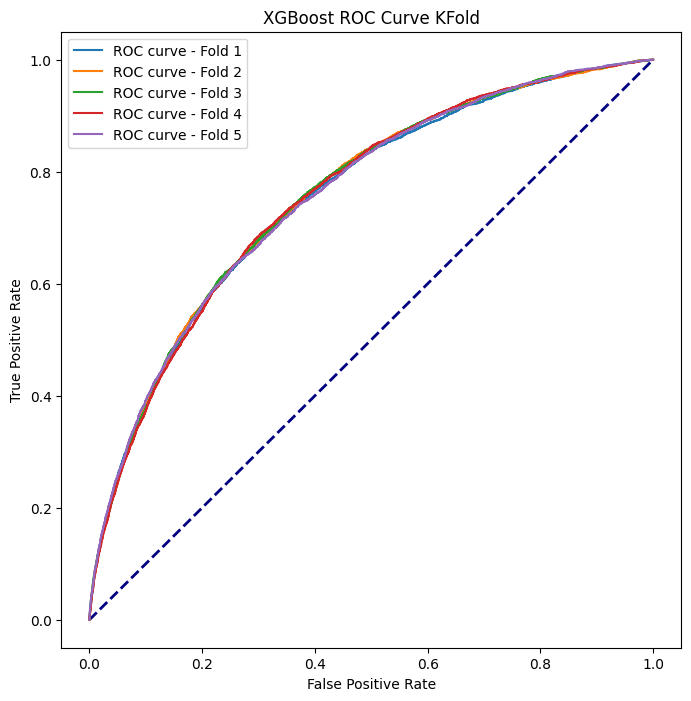

In [110]:
# Plotting XGBoost ROC curve for each fold
plt.figure(figsize=(8, 8))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
for i in range(num_folds):
    plt.plot(all_fpr[i], all_tpr[i], label=f'ROC curve - Fold {i + 1}')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost ROC Curve KFold')
plt.legend()
plt.show()

In [111]:
# Defining the XGBoost model
xgb_model = XGBClassifier(
    objective='binary:logistic',
    max_depth=4,
    learning_rate=0.01,
    n_estimators=1000,
    subsample=0.8,
    colsample_bytree=0.8,
    reg_lambda=1,
    reg_alpha=0,
    seed=0,
    num_parallel_tree=1,
    min_child_weight=1,
    eval_metric='auc',
    n_jobs=-1
)

# Training the XGBoost model on the whole training set
xgb_model.fit(X_train, y_train)

# Making predictions on the validation set
y_valid_pred = xgb_model.predict_proba(X_valid)[:, 1]

# Converting probabilities to binary predictions using a threshold of 0.5
y_pred_binary = (y_valid_pred > 0.5).astype(int)

# Evaluating on the validation set
accuracy = accuracy_score(y_valid, y_pred_binary)
f1 = f1_score(y_valid, y_pred_binary)
precision = precision_score(y_valid, y_pred_binary)

# Calculating ROC curve for the validation set
fpr, tpr, _ = roc_curve(y_valid, y_valid_pred)
roc_auc_curve = auc(fpr, tpr)

# Print evaluation metrics
print(f"Accuracy: {accuracy:.6f}")
print(f"F1 Score: {f1:.6f}")
print(f"Precision: {precision:.6f}")
print(f"ROC AUC: {roc_auc_curve:.6f}")

Accuracy: 0.919045
F1 Score: 0.008760
Precision: 0.611111
ROC AUC: 0.754415


Validation ROC AUC: 0.7544


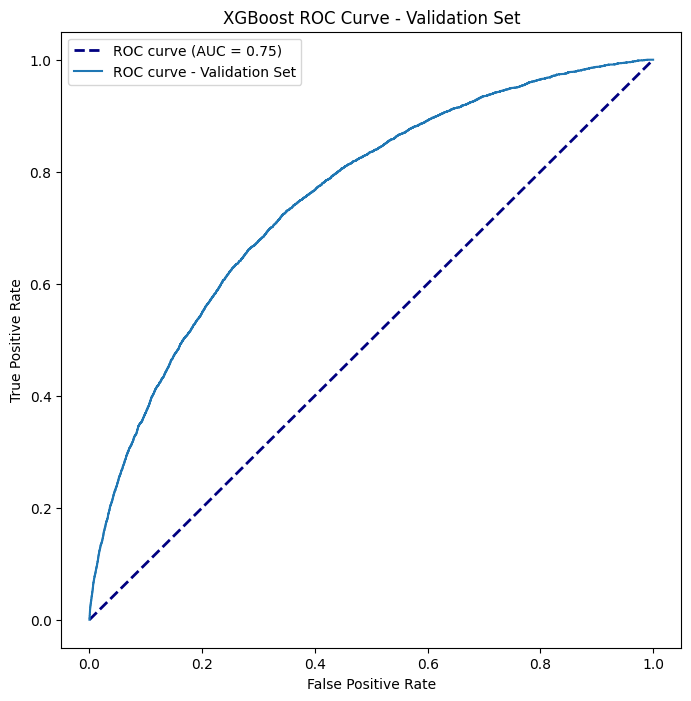

In [112]:
# Evaluating the model on the validation set
roc_auc = roc_auc_score(y_valid, y_valid_pred)

print(f'Validation ROC AUC: {roc_auc:.4f}')

# Plot XGBoost ROC curve for the validation set
fpr, tpr, _ = roc_curve(y_valid, y_valid_pred)
plt.figure(figsize=(8, 8))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot(fpr, tpr, label=f'ROC curve - Validation Set')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost ROC Curve - Validation Set')
plt.legend()
plt.show()